# DSCI 552 - Homework 7

### Name : Ashwin Chafale
### Github username : chafale
### USC-ID : 1990624801

In [1]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.metrics import hamming_loss, accuracy_score, make_scorer, calinski_harabasz_score
from sklearn.cluster import KMeans
import warnings
warnings.filterwarnings('ignore')

# 1. Multi-class and Multi-Label Classification Using Support Vector Machines

Download the [Anuran Calls (MFCCs) Data Set](https://archive.ics.uci.edu/ml/datasets/Anuran+Calls+%28MFCCs%29)

In [2]:
frog_df = pd.read_csv('../Data/Frogs_MFCCs.csv')
frog_df.head()

,MFCCs_ 1,MFCCs_ 2,MFCCs_ 3,MFCCs_ 4,MFCCs_ 5,MFCCs_ 6,MFCCs_ 7,MFCCs_ 8,MFCCs_ 9,MFCCs_10,...,MFCCs_17,MFCCs_18,MFCCs_19,MFCCs_20,MFCCs_21,MFCCs_22,Family,Genus,Species,RecordID
0,1.0,0.152936,-0.105586,0.200722,0.317201,0.260764,0.100945,-0.150063,-0.171128,0.124676,...,-0.108351,-0.077623,-0.009568,0.057684,0.118680,0.014038,Leptodactylidae,Adenomera,AdenomeraAndre,1
1,1.0,0.171534,-0.098975,0.268425,0.338672,0.268353,0.060835,-0.222475,-0.207693,0.170883,...,-0.090974,-0.056510,-0.035303,0.020140,0.082263,0.029056,Leptodactylidae,Adenomera,AdenomeraAndre,1
2,1.0,0.152317,-0.082973,0.287128,0.276014,0.189867,0.008714,-0.242234,-0.219153,0.232538,...,-0.050691,-0.023590,-0.066722,-0.025083,0.099108,0.077162,Leptodactylidae,Adenomera,AdenomeraAndre,1
3,1.0,0.224392,0.118985,0.329432,0.372088,0.361005,0.015501,-0.194347,-0.098181,0.270375,...,-0.136009,-0.177037,-0.130498,-0.054766,-0.018691,0.023954,Leptodactylidae,Adenomera,AdenomeraAndre,1
4,1.0,0.087817,-0.068345,0.306967,0.330923,0.249144,0.006884,-0.265423,-0.172700,0.266434,...,-0.048885,-0.053074,-0.088550,-0.031346,0.108610,0.079244,Leptodactylidae,Adenomera,AdenomeraAndre,1


In [3]:
# Check for empty values
frog_df.isna().any().any()

False

I have used [sklearn.preprocessing.LabelEncoder](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.LabelEncoder.html) to encode the classes in each label

In [4]:
df = frog_df[:]

le = LabelEncoder()
le_Family = le.fit_transform(df['Family'])
le_Genus = le.fit_transform(df['Genus'])
le_Species = le.fit_transform(df['Species'])

df['Family_En'] = le_Family
df['Genus_En'] = le_Genus
df['Species_En'] = le_Species
df.head()

,MFCCs_ 1,MFCCs_ 2,MFCCs_ 3,MFCCs_ 4,MFCCs_ 5,MFCCs_ 6,MFCCs_ 7,MFCCs_ 8,MFCCs_ 9,MFCCs_10,...,MFCCs_20,MFCCs_21,MFCCs_22,Family,Genus,Species,RecordID,Family_En,Genus_En,Species_En
0,1.0,0.152936,-0.105586,0.200722,0.317201,0.260764,0.100945,-0.150063,-0.171128,0.124676,...,0.057684,0.118680,0.014038,Leptodactylidae,Adenomera,AdenomeraAndre,1,3,0,0
1,1.0,0.171534,-0.098975,0.268425,0.338672,0.268353,0.060835,-0.222475,-0.207693,0.170883,...,0.020140,0.082263,0.029056,Leptodactylidae,Adenomera,AdenomeraAndre,1,3,0,0
2,1.0,0.152317,-0.082973,0.287128,0.276014,0.189867,0.008714,-0.242234,-0.219153,0.232538,...,-0.025083,0.099108,0.077162,Leptodactylidae,Adenomera,AdenomeraAndre,1,3,0,0
3,1.0,0.224392,0.118985,0.329432,0.372088,0.361005,0.015501,-0.194347,-0.098181,0.270375,...,-0.054766,-0.018691,0.023954,Leptodactylidae,Adenomera,AdenomeraAndre,1,3,0,0
4,1.0,0.087817,-0.068345,0.306967,0.330923,0.249144,0.006884,-0.265423,-0.172700,0.266434,...,-0.031346,0.108610,0.079244,Leptodactylidae,Adenomera,AdenomeraAndre,1,3,0,0


In [5]:
# X values
X = df.iloc[:,:-7]
X.head()

,MFCCs_ 1,MFCCs_ 2,MFCCs_ 3,MFCCs_ 4,MFCCs_ 5,MFCCs_ 6,MFCCs_ 7,MFCCs_ 8,MFCCs_ 9,MFCCs_10,...,MFCCs_13,MFCCs_14,MFCCs_15,MFCCs_16,MFCCs_17,MFCCs_18,MFCCs_19,MFCCs_20,MFCCs_21,MFCCs_22
0,1.0,0.152936,-0.105586,0.200722,0.317201,0.260764,0.100945,-0.150063,-0.171128,0.124676,...,-0.156436,0.082245,0.135752,-0.024017,-0.108351,-0.077623,-0.009568,0.057684,0.118680,0.014038
1,1.0,0.171534,-0.098975,0.268425,0.338672,0.268353,0.060835,-0.222475,-0.207693,0.170883,...,-0.254341,0.022786,0.163320,0.012022,-0.090974,-0.056510,-0.035303,0.020140,0.082263,0.029056
2,1.0,0.152317,-0.082973,0.287128,0.276014,0.189867,0.008714,-0.242234,-0.219153,0.232538,...,-0.237384,0.050791,0.207338,0.083536,-0.050691,-0.023590,-0.066722,-0.025083,0.099108,0.077162
3,1.0,0.224392,0.118985,0.329432,0.372088,0.361005,0.015501,-0.194347,-0.098181,0.270375,...,-0.317084,-0.011567,0.100413,-0.050224,-0.136009,-0.177037,-0.130498,-0.054766,-0.018691,0.023954
4,1.0,0.087817,-0.068345,0.306967,0.330923,0.249144,0.006884,-0.265423,-0.172700,0.266434,...,-0.298524,0.037439,0.219153,0.062837,-0.048885,-0.053074,-0.088550,-0.031346,0.108610,0.079244


In [6]:
# 3 labels: Family, Genus, Species
y_family = df.loc[:,'Family']
y_genus = df.loc[:,'Genus']
y_species = df.loc[:,'Species']

In [7]:
# Encoded 3 labels: Family_En, Genus_En, Species_En
# Here postfix En represents Encoded
y_family_encoded = df.loc[:,'Family_En']
y_genus_encoded = df.loc[:,'Genus_En']
y_species_encoded = df.loc[:,'Species_En']

### 1 (a) Choose 70% of the data randomly as the training set

In [8]:
# Family label
X_train, X_test, y_trainFamily, y_testFamily = train_test_split(X, y_family, train_size=0.7, test_size=0.3, random_state=19)

# Genus label
_, _, y_trainGenus, y_testGenus = train_test_split(X, y_genus, train_size=0.7, test_size=0.3, random_state=19)

# Species label
_, _, y_trainSpecies, y_testSpecies = train_test_split(X, y_species, train_size=0.7, test_size=0.3, random_state=19)

## 1 (b) i. Research exact match and hamming score/ loss methods for evaluating multilabel classification and use them in evaluating the classifiers in this problem

In the scikit-learn library I have found that ` exact-match ` corresponds to <font color='red'>`accuracy_score()`</font> and ` hamming score/loss ` corresponds to <font color='red'>`hamming_loss()`</font>.

<https://scikit-learn.org/stable/modules/generated/sklearn.metrics.accuracy_score.html#sklearn-metrics-accuracy-score>
<https://scikit-learn.org/stable/modules/generated/sklearn.metrics.hamming_loss.html#sklearn-metrics-hamming-loss>

Reference:
Multi-Label Classification problems <https://www.analyticsvidhya.com/blog/2017/08/introduction-to-multi-label-classification/>


## 1 (b) ii. Train a SVM for each of the labels, using Gaussian kernels and one versus all classifiers. Determine the weight of the SVM penalty and the width of the Gaussian Kernel using 10 fold cross validation.

### SVM (Gaussian Kernels and One versus All):  Raw Data - (Imbalanced data)

In [28]:
from sklearn.svm import SVC, LinearSVC

In [20]:
# initialize cross-validation parameter 'C' and 'gamma' for SVC
params_dict = {'C': np.logspace(-1, 5, 10), 'gamma': np.linspace(0.0001, 10, 10)}
svc = SVC(kernel='rbf')

# cv = 10 folds
svm_CV_accuracy = GridSearchCV(estimator=svc, param_grid=params_dict, cv=10, scoring=make_scorer(accuracy_score), n_jobs=6)

y_labels = [y_trainFamily, y_trainGenus, y_trainSpecies]
labels = ['Family', 'Genus', 'Species']

best_params_list =[]
best_CV_score_list=[]
hamming_list=[]
accuracy_list=[]

current_label = ""
current_y_test = ""

for y in y_labels:
    svm_CV_accuracy.fit(X_train, y)
    best_params_list.append(svm_CV_accuracy.best_params_)
    best_CV_score_list.append(svm_CV_accuracy.best_score_)

    if 'Family' in str(y):
        current_label='Family'
        current_y_test = y_testFamily
    elif 'Genus' in str(y):
        current_label='Genus'
        current_y_test = y_testGenus
    elif 'Species' in str(y):
        current_label='Species'
        current_y_test = y_testSpecies

    print("Best < C , gamma > values for the {} label = {}".format(current_label, svm_CV_accuracy.best_params_))
    print("CV Score for the {} label =  {}".format(current_label, svm_CV_accuracy.best_score_))

    y_predict = svm_CV_accuracy.predict(X_test)

    # Hamming loss
    current_hamming = hamming_loss(current_y_test, y_predict)
    hamming_list.append(current_hamming)
    print("Hamming loss of {} label = {}".format(current_label, current_hamming))

    # Exact match
    current_accuracy = accuracy_score(current_y_test, y_predict)
    accuracy_list.append(current_accuracy)
    print("Exact match score of {} label = {}".format(current_label, current_accuracy))
    print("")


Best < C , gamma > values for the Family label = {'C': 10.0, 'gamma': 3.3334}
CV Score for the Family label =  0.9934460696140617
Hamming loss of Family label = 0.006947660954145438
Exact match score of Family label = 0.9930523390458545

Best < C , gamma > values for the Genus label = {'C': 10.0, 'gamma': 3.3334}
CV Score for the Genus label =  0.9916579885764776
Hamming loss of Genus label = 0.014358499305233904
Exact match score of Genus label = 0.9856415006947661

Best < C , gamma > values for the Species label = {'C': 10.0, 'gamma': 1.1112}
CV Score for the Species label =  0.9914607592539999
Hamming loss of Species label = 0.01157943492357573
Exact match score of Species label = 0.9884205650764243



### SVM (Gaussian Kernels and One versus All): Standardized Data - (Imbalanced data)
I have standardized the data using [sklearn.preprocessing.StandardScaler](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html)

In [21]:
# Standardize the data
sc = StandardScaler()

X_train_sc = sc.fit_transform(X_train)
X_test_sc = sc.fit_transform(X_test)

params_dict = {'C': np.logspace(-1, 5, 10), 'gamma': np.linspace(0.0001, 10, 10)}

svc = SVC(kernel='rbf')

svc_CV_standardized = GridSearchCV(estimator=svc, param_grid=params_dict, cv=10, scoring=make_scorer(accuracy_score), n_jobs=6)

y_labels = [y_trainFamily, y_trainGenus, y_trainSpecies]

best_params_Std_list =[]
best_CV_score_Std_list=[]
hamming_Std_list=[]
accuracy_Std_list=[]

for y_ in y_labels:
    svc_CV_standardized.fit(X_train_sc, y_)
    best_params_Std_list.append(svc_CV_standardized.best_params_)
    best_CV_score_Std_list.append(svc_CV_standardized.best_score_)

    if 'Family' in str(y_):
        current_label='Family'
        current_y_test = y_testFamily
    elif 'Genus' in str(y_):
        current_label='Genus'
        current_y_test = y_testGenus
    elif 'Species' in str(y_):
        current_label='Species'
        current_y_test = y_testSpecies

    print("Best < C , gamma > values for the {} label = {}".format(current_label, svc_CV_standardized.best_params_))
    print("CV Score for the {} label =  {}".format(current_label, svc_CV_standardized.best_score_))

    y_predict_Std = svc_CV_standardized.predict(X_test_sc)

    # Hamming loss
    current_hamming = hamming_loss(current_y_test, y_predict_Std)
    hamming_Std_list.append(current_hamming)
    print("Hamming loss of {} label = {}".format(current_label, current_hamming))

    # Exact match
    current_accuracy = accuracy_score(current_y_test, y_predict_Std)
    accuracy_Std_list.append(current_accuracy)
    print("Exact match score of {} label = {}".format(current_label, current_accuracy))
    print("")

Best < C , gamma > values for the Family label = {'C': 100000.0, 'gamma': 0.0001}
CV Score for the Family label =  0.9803393922181198
Hamming loss of Family label = 0.019453450671607225
Exact match score of Family label = 0.9805465493283928

Best < C , gamma > values for the Genus label = {'C': 100000.0, 'gamma': 0.0001}
CV Score for the Genus label =  0.9829219129666447
Hamming loss of Genus label = 0.018990273274664196
Exact match score of Genus label = 0.9810097267253358

Best < C , gamma > values for the Species label = {'C': 100000.0, 'gamma': 0.0001}
CV Score for the Species label =  0.9809372517871326
Hamming loss of Species label = 0.0222325150532654
Exact match score of Species label = 0.9777674849467346



### Result of SVM (Gaussian Kernels and One versus All): Standardized vs Raw Imbalanced data
When we compare our SVM exact mach score results for raw data vs standardized data, we find that the exact match scores for standardized data are less than the raw data. We therefore conclude that using the raw data for this data set in a support vector machine classifier is preferred over the standardized data as it produces a slightly higher level of accuracy.

## 1 (b) iii. $\mathscr{L}_1$-Penalized SVMs

###  $\mathscr{L}_1$-Penalized SVMs:  Raw Imbalanced Data

In [26]:
params_L1_dict = {'C': np.logspace(-5, 1, 10)}

# L1 penalty
svc_L1 = LinearSVC(penalty='l1', dual=False, random_state=19, max_iter=10000000)

svc_L1_CV = GridSearchCV(estimator=svc_L1, param_grid=params_L1_dict, cv=10, scoring=make_scorer(accuracy_score), n_jobs=8)

y_labels = [y_trainFamily, y_trainGenus, y_trainSpecies]

best_params_L1_list =[]
best_CV_score_L1_list=[]
hamming_L1_list=[]
accuracy_L1_list=[]

for y in y_labels:
    svc_L1_CV.fit(X_train, y)
    best_params_L1_list.append(svc_L1_CV.best_params_)
    best_CV_score_L1_list.append(svc_L1_CV.best_score_)

    if 'Family' in str(y):
        current_label='Family'
        current_y_test = y_testFamily
    elif 'Genus' in str(y):
        current_label='Genus'
        current_y_test = y_testGenus
    elif 'Species' in str(y):
        current_label='Species'
        current_y_test = y_testSpecies

    print("Best < C > values for the {} label = {}".format(current_label, svc_L1_CV.best_params_))
    print("CV Score for the {} label =  {}".format(current_label, svc_L1_CV.best_score_))

    y_predict_L1 = svc_L1_CV.predict(X_test)

    # Hamming loss
    current_hamming = hamming_loss(current_y_test, y_predict_L1)
    hamming_L1_list.append(current_hamming)
    print("Hamming loss of {} label = {}".format(current_label, current_hamming))

    # Exact match
    current_accuracy = accuracy_score(current_y_test, y_predict_L1)
    accuracy_L1_list.append(current_accuracy)
    print("Exact match score of {} label = {}".format(current_label, current_accuracy))
    print("")

Best < C > values for the Family label = {'C': 10.0}
CV Score for the Family label =  0.9376506832023731
Hamming loss of Family label = 0.06530801296896711
Exact match score of Family label = 0.9346919870310328

Best < C > values for the Genus label = {'C': 10.0}
CV Score for the Genus label =  0.9535355328347375
Hamming loss of Genus label = 0.048170449282075034
Exact match score of Genus label = 0.951829550717925

Best < C > values for the Species label = {'C': 10.0}
CV Score for the Species label =  0.960087490927451
Hamming loss of Species label = 0.04400185270958777
Exact match score of Species label = 0.9559981472904122



###  $\mathscr{L}_1$-Penalized SVMs:  Standardized Imbalanced Data

In [23]:
# Standardize the data
sc = StandardScaler()

X_train_sc = sc.fit_transform(X_train)
X_test_sc = sc.fit_transform(X_test)

params_L1_dict = {'C': np.logspace(-5, 1, 10)}
svc_L1 = LinearSVC(penalty='l1', dual=False, random_state=19, max_iter=100000)

svc_L1_CV_standardized = GridSearchCV(estimator=svc_L1, param_grid=params_L1_dict, cv=10, scoring=make_scorer(accuracy_score), n_jobs=8)

y_labels = [y_trainFamily, y_trainGenus, y_trainSpecies]

best_params_L1_std_list =[]
best_CV_score_L1_std_list=[]
hamming_L1_std_list=[]
accuracy_L1_std_list=[]

for y in y_labels:
    svc_L1_CV_standardized.fit(X_train_sc, y)
    best_params_L1_std_list.append(svc_L1_CV_standardized.best_params_)
    best_CV_score_L1_std_list.append(svc_L1_CV_standardized.best_score_)

    if 'Family' in str(y):
        current_label='Family'
        current_y_test = y_testFamily
    elif 'Genus' in str(y):
        current_label='Genus'
        current_y_test = y_testGenus
    elif 'Species' in str(y):
        current_label='Species'
        current_y_test = y_testSpecies

    print("Best < C > values for the {} label = {}".format(current_label, svc_L1_CV_standardized.best_params_))
    print("CV Score for the {} label =  {}".format(current_label, svc_L1_CV_standardized.best_score_))

    y_predict_L1_Std = svc_L1_CV_standardized.predict(X_test_sc)

    # Hamming loss
    current_hamming = hamming_loss(current_y_test, y_predict_L1_Std)
    hamming_L1_std_list.append(current_hamming)
    print("Hamming loss of {} label = {}".format(current_label, current_hamming))

    # Exact match
    current_accuracy = accuracy_score(current_y_test, y_predict_L1_Std)
    accuracy_L1_std_list.append(current_accuracy)
    print("Exact match score of {} label = {}".format(current_label, current_accuracy))
    print("")


Best < C > values for the Family label = {'C': 10.0}
CV Score for the Family label =  0.937847498014297
Hamming loss of Family label = 0.06947660954145438
Exact match score of Family label = 0.9305233904585456

Best < C > values for the Genus label = {'C': 10.0}
CV Score for the Genus label =  0.9547259729944401
Hamming loss of Genus label = 0.04863362667901806
Exact match score of Genus label = 0.951366373320982

Best < C > values for the Species label = {'C': 10.0}
CV Score for the Species label =  0.9618745035742653
Hamming loss of Species label = 0.0444650301065308
Exact match score of Species label = 0.9555349698934692




From above results, I think raw data should be preferred over standardized data.

## 1 (b) iv. $\mathscr{L}_1$-Penalized SVMs with (SMOTE) Balanced Data

### $\mathscr{L}_1$-Penalized SVMs:  Raw (SMOTE) Data

In [27]:
params_L1_dict = {'C': np.logspace(-5, 1, 10)}
svc_L1_balanced = LinearSVC(penalty='l1', class_weight='balanced', dual=False, random_state=19, max_iter=10000000)

svc_L1_CV_balanced = GridSearchCV(estimator=svc_L1_balanced, param_grid=params_L1_dict, cv=10, scoring=make_scorer(accuracy_score), n_jobs=8)

y_labels = [y_trainFamily, y_trainGenus, y_trainSpecies]

best_params_L1_bal_list =[]
best_CV_score_L1_bal_list = []
hamming_L1_bal_list = []
accuracy_L1_bal_list = []

for y in y_labels:
    svc_L1_CV_balanced.fit(X_train, y)
    best_params_L1_bal_list.append(svc_L1_CV_balanced.best_params_)
    best_CV_score_L1_bal_list.append(svc_L1_CV_balanced.best_score_)

    if 'Family' in str(y):
        current_label='Family'
        current_y_test = y_testFamily
    elif 'Genus' in str(y):
        current_label='Genus'
        current_y_test = y_testGenus
    elif 'Species' in str(y):
        current_label='Species'
        current_y_test = y_testSpecies
    
    print("Best < C > values for the {} label = {}".format(current_label, svc_L1_CV_balanced.best_params_))
    print("CV Score for the {} label =  {}".format(current_label, svc_L1_CV_balanced.best_score_))

    y_predict_L1_balanced = svc_L1_CV_balanced.predict(X_test)
    
    # Hamming loss
    current_hamming = hamming_loss(current_y_test, y_predict_L1_balanced)
    hamming_L1_bal_list.append(current_hamming)
    print("Hamming loss of {} label = {}".format(current_label, current_hamming))
    
    # Exact match
    current_accuracy = accuracy_score(current_y_test, y_predict_L1_balanced)
    accuracy_L1_bal_list.append(current_accuracy)
    print("Exact match score of {} label = {}".format(current_label, current_accuracy))
    print("")

Best < C > values for the Family label = {'C': 10.0}
CV Score for the Family label =  0.9310979361923696
Hamming loss of Family label = 0.07179249652616952
Exact match score of Family label = 0.9282075034738305

Best < C > values for the Genus label = {'C': 10.0}
CV Score for the Genus label =  0.945791915175613
Hamming loss of Genus label = 0.053265400648448355
Exact match score of Genus label = 0.9467345993515517

Best < C > values for the Species label = {'C': 10.0}
CV Score for the Species label =  0.9604843163242764
Hamming loss of Species label = 0.04492820750347383
Exact match score of Species label = 0.9550717924965262



### $\mathscr{L}_1$-Penalized SVMs:  Standardized (SMOTE) Data

In [25]:
# Standardize the data
sc = StandardScaler()

X_train_sc = sc.fit_transform(X_train)
X_test_sc = sc.fit_transform(X_test)

params_L1_dict = {'C': np.logspace(-5, 1, 10)}
svc_L1_bal_std = LinearSVC(penalty='l1', class_weight='balanced', dual=False, random_state=19, max_iter=100000)

svc_L1_CV_balanced_standardized = GridSearchCV(estimator=svc_L1_bal_std, param_grid=params_L1_dict, cv=10, scoring=make_scorer(accuracy_score), n_jobs=8)

y_labels = [y_trainFamily, y_trainGenus, y_trainSpecies]

best_params_L1_bal_std_list = []
best_CV_score_L1_bal_std_list = []
hamming_L1_bal_std_list=[]
accuracy_L1_bal_std_list=[]

for y in y_labels:
    svc_L1_CV_balanced_standardized.fit(X_train_sc, y)
    best_params_L1_bal_std_list.append(svc_L1_CV_balanced_standardized.best_params_)
    best_CV_score_L1_bal_std_list.append(svc_L1_CV_balanced_standardized.best_score_)

    if 'Family' in str(y):
        current_label='Family'
        current_y_test = y_testFamily
    elif 'Genus' in str(y):
        current_label='Genus'
        current_y_test = y_testGenus
    elif 'Species' in str(y):
        current_label='Species'
        current_y_test = y_testSpecies
    
    print("Best < C > values for the {} label = {}".format(current_label, svc_L1_CV_balanced_standardized.best_params_))
    print("CV Score for the {} label =  {}".format(current_label, svc_L1_CV_balanced_standardized.best_score_))

    y_predict_L1_bal_std = svc_L1_CV_balanced_standardized.predict(X_test_sc)
    
    # Hamming loss
    current_hamming = hamming_loss(current_y_test, y_predict_L1_bal_std)
    hamming_L1_bal_std_list.append(current_hamming)
    print("Hamming loss of {} label = {}".format(current_label, current_hamming))
    
    # Exact match
    current_accuracy = accuracy_score(current_y_test, y_predict_L1_bal_std)
    accuracy_L1_bal_std_list.append(current_accuracy)
    print("Exact match score of {} label = {}".format(current_label, current_accuracy))
    print("")

Best < C > values for the Family label = {'C': 2.154434690031882}
CV Score for the Family label =  0.9312967433494274
Hamming loss of Family label = 0.07596109309865678
Exact match score of Family label = 0.9240389069013432

Best < C > values for the Genus label = {'C': 0.46415888336127725}
CV Score for the Genus label =  0.946387153270851
Hamming loss of Genus label = 0.052802223251505326
Exact match score of Genus label = 0.9471977767484947

Best < C > values for the Species label = {'C': 10.0}
CV Score for the Species label =  0.9612779671179273
Hamming loss of Species label = 0.04400185270958777
Exact match score of Species label = 0.9559981472904122



From above result I would choose SMOTE raw-data over SMOTE standardized data because of better accuracy

# 2. K-Means Clustering on a Multi-Class and Multi-Label Data Set
**Monte-Carlo Simulation:** Perform the following procedures 50 times, and report the average and standard deviation of the 50 Hamming Distances that you calculate

## 2 (a) Use k-means clustering on the whole Anuran Calls (MFCCs) Data Set

In [30]:
best_k = ""

family_hamming_loss = []
genus_hamming_loss = []
species_hamming_loss = []

# Monte-Carlo simulation 50 times
for n in range(1,51):
    labels_list = []
    CH_score_list = []

    seed = np.random.randint(0, 1000)

    for k in range (2,51):
        km = KMeans(n_clusters=k, random_state=seed).fit(X)
        labels = km.labels_
        labels_list.append(labels)

        # CH score
        CH_score = calinski_harabasz_score(X, labels)
        CH_score_list.append(CH_score)

        if CH_score == max(CH_score_list):
            best_k = k

    # Using best_k to fit the model
    km_best = KMeans(n_clusters=best_k).fit(X)
    labels_best = km_best.labels_

    df_k = pd.DataFrame({'k_label': labels_best,
                        'Family':df['Family'].copy(),
                        'Genus':df['Genus'].copy(),
                        'Species':df['Species'].copy()})

    family_majority = df_k.groupby(['k_label'])['Family'].agg(pd.Series.mode)
    genus_majority = df_k.groupby(['k_label'])['Genus'].agg(pd.Series.mode)
    species_majority = df_k.groupby(['k_label'])['Species'].agg(pd.Series.mode)

    family_majority_dict = {}
    genus_majority_dict = {}
    species_majority_dict = {}
    all_majority_dict = {}

    for x in range(0, len(set(labels_best))):
        family_majority_dict[x] = family_majority[x]
        genus_majority_dict[x] = genus_majority[x]
        species_majority_dict[x] = species_majority[x]
        all_majority_dict[x] = (family_majority[x], genus_majority[x], species_majority[x])

    df_hamming = df_k.copy()
    family_predict_list = []
    genus_predict_list = []
    species_predict_list = []

    for idx, row in df_hamming.iterrows():
        current_label = row['k_label']
        family_predict_list.append(family_majority_dict[current_label])
        genus_predict_list.append(genus_majority_dict[current_label])
        species_predict_list.append(species_majority_dict[current_label])

    df_hamming['Family_predict'] = family_predict_list
    df_hamming['Genus_predict'] = genus_predict_list
    df_hamming['Species_predict'] = species_predict_list

    # Calculate hamming loss
    family_hamming = hamming_loss(df['Family'], df_hamming['Family_predict'])
    family_hamming_loss.append(family_hamming)

    genus_hamming = hamming_loss(df['Genus'], df_hamming['Genus_predict'])
    genus_hamming_loss.append(genus_hamming)

    species_hamming = hamming_loss(df['Species'], df_hamming['Species_predict'])
    species_hamming_loss.append(species_hamming)

    print('=========== MONTE-CARLO SIMULATION {} ==========='.format(n))
    print('Highest CH score = {}, for k value = {}'.format(max(CH_score_list), best_k))
    print('For clusters k = {}, the Majority triplet are : '.format(best_k))
    print(all_majority_dict)
    print('Hamming loss for the Family label = {}'.format(family_hamming))
    print('Hamming loss for the Genus label = {}'.format(genus_hamming))
    print('Hamming loss for the Species label = {}'.format(species_hamming))
    print("\n")

=========== MONTE-CARLO SIMULATION 1 ===========
Highest CH score = 3680.7413494630905, for k value = 2
For clusters k = 2, the Majority triplet are : 
{0: ('Hylidae', 'Hypsiboas', 'HypsiboasCordobae'), 1: ('Leptodactylidae', 'Adenomera', 'AdenomeraHylaedactylus')}
Hamming loss for the Family label = 0.2334954829742877
Hamming loss for the Genus label = 0.2982626824183461
Hamming loss for the Species label = 0.3638637943015983


=========== MONTE-CARLO SIMULATION 2 ===========
Highest CH score = 3680.7413494630905, for k value = 2
For clusters k = 2, the Majority triplet are : 
{0: ('Hylidae', 'Hypsiboas', 'HypsiboasCordobae'), 1: ('Leptodactylidae', 'Adenomera', 'AdenomeraHylaedactylus')}
Hamming loss for the Family label = 0.2334954829742877
Hamming loss for the Genus label = 0.2982626824183461
Hamming loss for the Species label = 0.3638637943015983


=========== MONTE-CARLO SIMULATION 3 ===========
Highest CH score = 3680.7413494630905, for k value = 2
For clusters k = 2, the Majori

## 2 (b) In each cluster, determine which family is the majority by reading the true labels.
In all 50 Monte-Carlo simulations we can observe cluster size k = 2.
By observing all simulations we have found a majority label triplet (Family, Genus, Species) are of (‘Hylidae’, ‘Hypsiboas’, ‘HypsiboasCordobae’), or (‘Leptodactylidae’, ‘Adenomera’, ‘AdenomeraHylaedactylus’).

## 2 (c) Calculate the average Hamming distance, Hamming score, and Hamming loss for each cluster having a majority label triplet (family, genus, species)

## Average and Standard Deviation of the 50 Hamming Loss

In [32]:
df_hamming_loss = pd.DataFrame({'Family_Hamming_Loss':family_hamming_loss,
                               'Genus_Hamming_Loss':genus_hamming_loss,
                               'Species_Hamming_Loss':species_hamming_loss})
avg_hamming_list = df_hamming_loss.mean(axis=1)
df_hamming_loss['Average_Hamming_loss']=avg_hamming_list
df_hamming_loss

,Family_Hamming_Loss,Genus_Hamming_Loss,Species_Hamming_Loss,Average_Hamming_loss
0,0.233495,0.298263,0.363864,0.298541
1,0.233495,0.298263,0.363864,0.298541
2,0.233495,0.298263,0.363864,0.298541
3,0.233495,0.298263,0.363864,0.298541
4,0.233495,0.298263,0.363864,0.298541
5,0.233495,0.298263,0.363864,0.298541
6,0.233495,0.298263,0.363864,0.298541
7,0.233495,0.298263,0.363864,0.298541
8,0.233495,0.298263,0.363864,0.298541
9,0.233495,0.298263,0.363864,0.298541


In [34]:
df_hamming_loss.describe().loc[['mean','std']]

,Family_Hamming_Loss,Genus_Hamming_Loss,Species_Hamming_Loss,Average_Hamming_loss
mean,0.233495,2.982627e-01,3.638638e-01,2.985407e-01
std,0.000000,3.925231e-16,1.121495e-16,1.682242e-16


# ISLR
## ISLR 12.6.2

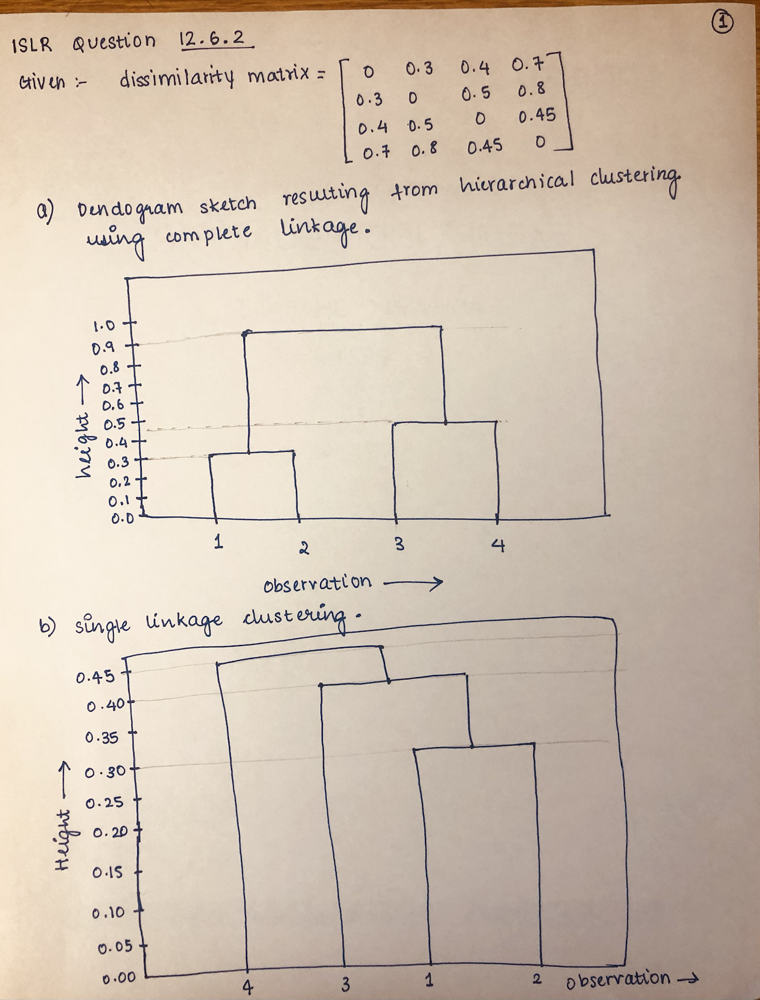

In [42]:
from IPython.display import Image
Image(filename="img2.png")

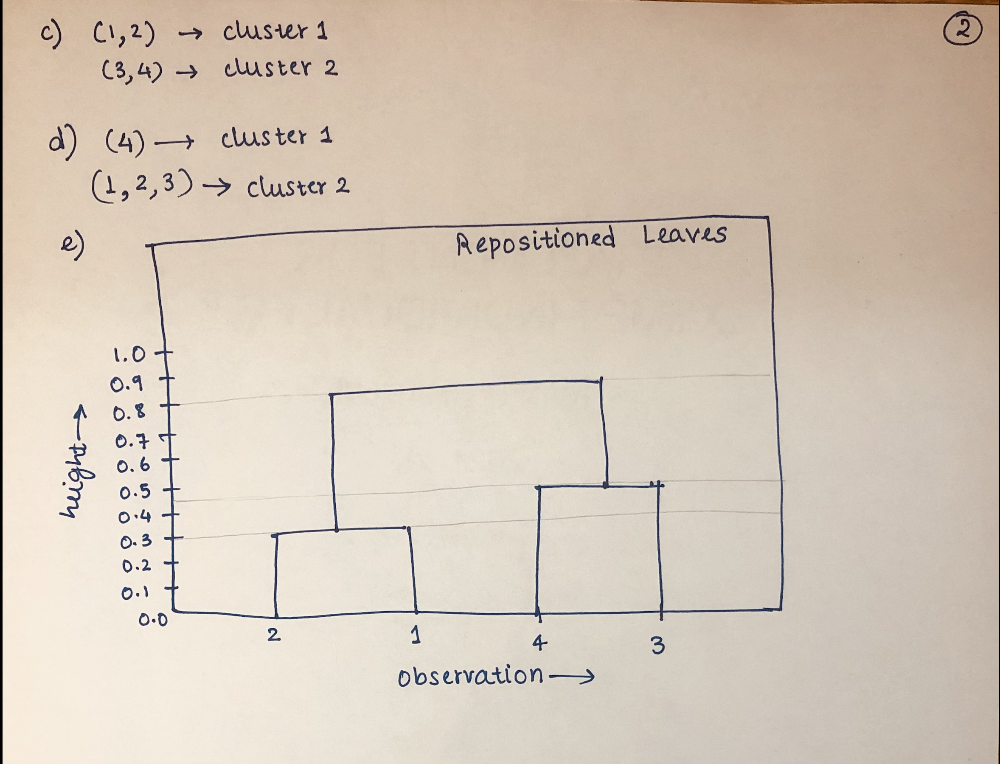

In [43]:
Image(filename="img1.png")

# References

Jain, Shubham. Solving Multi-Label Classification problems: <https://www.analyticsvidhya.com/blog/2017/08/introduction-to-multi-label-classification/>

Nooney, Kartik. Deep dive into multi-label classification: <https://towardsdatascience.com/journey-to-the-center-of-multi-label-classification-384c40229bff>

scikit-learn's GridSearchCV: <https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.GridSearchCV.html>

scikit-learn's KMeans:  <https://scikit-learn.org/stable/modules/clustering.html#k-means>

scikit-learn's model evaluation:  <https://scikit-learn.org/stable/modules/model_evaluation.html>

scikit-learn's support vector machines:  <https://scikit-learn.org/stable/modules/svm.html>

Sorower, Mohammad. A Literature Survey on Algorithms for Multi-label Learning: <https://pdfs.semanticscholar.org/6b56/91db1e3a79af5e3c136d2dd322016a687a0b.pdf>